In [1]:
import numpy as np
import scipy as sp
import torch as th

import os, pdb, sys, json, glob, tqdm
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import h5py

sns.set_style('whitegrid')

sns.set_context('notebook')

%matplotlib inline
plt.rcParams['figure.figsize'] = [10, 10]
plt.rcParams['figure.dpi'] = 200
sns.set(context='poster',
        style='ticks',
        font_scale=1,
        rc={'axes.grid':True,
            'grid.color':'.9',
            'grid.linewidth':0.75})
%load_ext autoreload
%autoreload 2

root = '/home/ubuntu/ext_vol'
import sys
sys.path.insert(0, f'{root}/inpca')

from utils import get_data, get_idx, triplot, plotly_3d

/home/ubuntu/miniconda3/envs/inpca/lib/python3.9/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: /home/ubuntu/miniconda3/envs/inpca/lib/python3.9/site-packages/torchvision/image.so: undefined symbol: _ZN5torch3jit17parseSchemaOrNameERKSs
  warn(f"Failed to load image Python extension: {e}")


In [2]:
import plotly.graph_objects as go
import numpy as np
import plotly.offline as pyo
import pandas as pd
pyo.init_notebook_mode()
from matplotlib.lines import Line2D    
from utils import CDICT_M, plot_explained_var

In [84]:
fn = 'allcnn_geod'
k = 'yh'

didx = th.load(f'{root}/inpca/inpca_results_all/corners/didx_{fn}.p')
r = th.load(f'{root}/inpca/inpca_results_all/corners/r_{k}_{fn}.p')
didx['iseed'] = didx.iseed.astype(str)

In [94]:
colors =  plt.get_cmap('rocket', 12).colors[8::-2]
cdict = {'nan':colors[0]}
for i in range(3):
    cdict[str(float(i))] = colors[i+1]

In [95]:
fig = plotly_3d(dc=didx.reset_index(drop=True), r=r,
          opacity=0.5,
          color_axis=True,
          dims=[1,2,3],
          ne=3,
          color='iseed', 
            discrete_c=True,
          # colorscale='RdBu',
          cdict=cdict,
          legend=True,
          cols=['seed',  'm', 'opt', 't',  'iseed', 'isinit', 'err', 'verr', 
                'bs', 'aug', 'lr', 'wd'],
          xrange=[-2,2],
          yrange=[-2,2],
          zrange=[-2, 2]
          )
fig.show()

[4810.5854  -791.1873   378.9854   354.69577  348.10333  292.1766
  103.34926]


In [62]:
fn = 'corner0_only'
k = 'yh'

didx = th.load(f'{root}/inpca/inpca_results_all/corners/didx_{fn}.p')
r = th.load(f'{root}/inpca/inpca_results_all/corners/r_{k}_{fn}.p')

In [66]:
ii = didx[didx.seed.isin([0,44,46,47,48,50])].index
didx = didx.iloc[ii].reset_index(drop=True)
r['xp'] = r['xp'][ii, :]

In [67]:
for seed in [44,46,47,48,50]:
    didx.loc[didx.seed==seed, 'm'] = f'allcnn{seed}'
didx.loc[didx.isinit==True, 'm'] = 'tocorner'

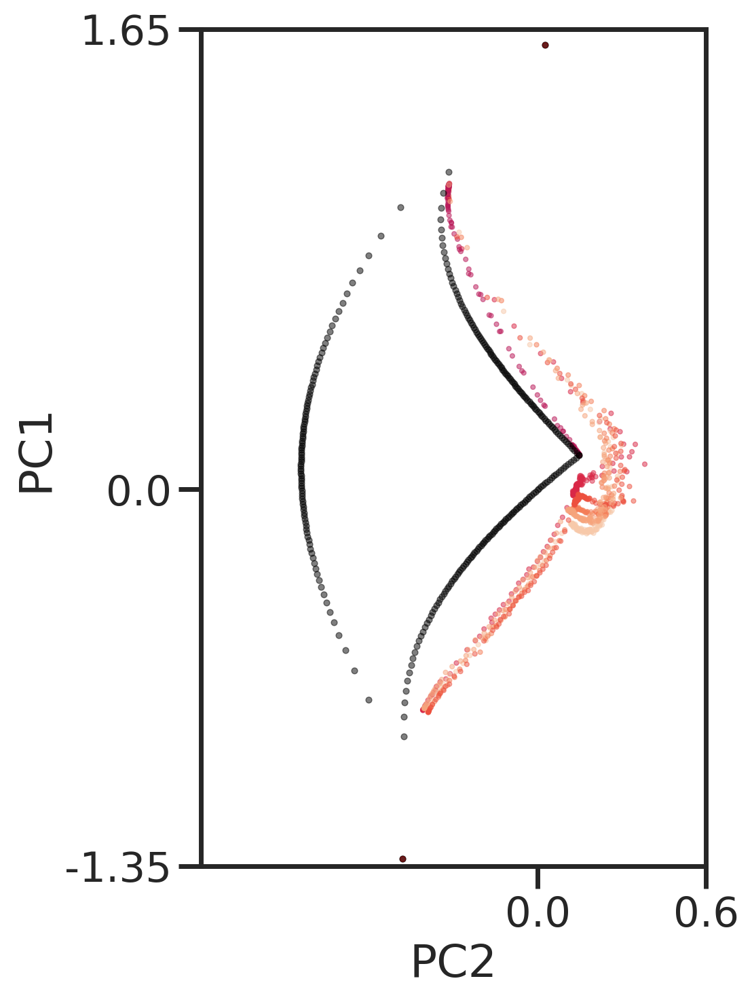

In [68]:
colors =  plt.get_cmap('rocket', 12).colors[5:11]
cdict = {'tocorner':colors[0]}
for (i, seed) in enumerate([44, 48, 47,50,46]):
    cdict[f'allcnn{seed}'] = colors[i+1]
emph = list(didx[didx.m.isin(['0geodesic', 'geodesic', 'tocorner0_geodesic'])].index)
f, gs = triplot(didx, r,
                emph = {'geodesic': emph, 'p01':[0], 'ps':[99]},
                empsize={'geodesic':10, 'p01':8, 'ps':8},
                empcolor={'geodesic':'black'},
                ckey='m', 
                discrete_c=True, 
                s=6,
                cdict=cdict,
                grid_ratio=[5,3], grid_size=0.3, centers=[0.15, -0.3],
            )